Iris Example from 
<br>
https://scikit-learn.org/stable/tutorial/basic/tutorial.html

1) Nearest Neighbor

In this exercise we are going to attempt to classify iris base on their sepal length, sepal width, petal length, petal width.
<br>Setosa have narror short petals and short sepal (small)
<br>Vericolor have wide petals and sepal (medium)
<br>Virginica have long narror petals and long sepal (large)


In [1]:
#From Scikit learn we are going to import the iris data set
from sklearn import datasets
import numpy as np
#This will load all the iris data including meta data about the data set
iris = datasets.load_iris()
#If we only want to see the data for iris
irisData = iris.data
irisData[0:15]

array([[5.1, 3.5, 1.4, 0.2],
       [4.9, 3. , 1.4, 0.2],
       [4.7, 3.2, 1.3, 0.2],
       [4.6, 3.1, 1.5, 0.2],
       [5. , 3.6, 1.4, 0.2],
       [5.4, 3.9, 1.7, 0.4],
       [4.6, 3.4, 1.4, 0.3],
       [5. , 3.4, 1.5, 0.2],
       [4.4, 2.9, 1.4, 0.2],
       [4.9, 3.1, 1.5, 0.1],
       [5.4, 3.7, 1.5, 0.2],
       [4.8, 3.4, 1.6, 0.2],
       [4.8, 3. , 1.4, 0.1],
       [4.3, 3. , 1.1, 0.1],
       [5.8, 4. , 1.2, 0.2]])

In [2]:
#To see the target names
iris.target_names

array(['setosa', 'versicolor', 'virginica'], dtype='<U10')

In [3]:
#Then the target
iris.target

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2])

In [4]:
#We know that the first 50 of the data set are classified as setosa, the next fifty are versicolor and the last fifty are virginica
#from the target_names array
iris.target.tolist().count(0)


50

In [5]:
#If we look at the 1st, 51st and 101st element of the data array, we can have an idea of length and width of the pedal and sepal
#for each of the iris names
#Setosa
iris.data[0]


array([5.1, 3.5, 1.4, 0.2])

In [6]:
#Versicolor
iris.data[51]

array([6.4, 3.2, 4.5, 1.5])

In [7]:
#Virginica
iris.data[101]

array([5.8, 2.7, 5.1, 1.9])

We can see the numbers get somewhat larger, if you print out the entire data set it would be more clear that the the dataset is increasing

In [8]:
#We can split the iris dataset into our training and test data
#iris_X is going to contain all 150 of our iris datase
#iris_y is going to contain all 150 of our target
iris_X, iris_y = datasets.load_iris(return_X_y=True)
iris_X[0:10]
iris_y[0:10]

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [9]:
#Generate 150 random number, permutation means to generate/permute a sequence of numbers
np.random.seed(0)
indices = np.random.permutation(len(iris_X))
indices

array([114,  62,  33, 107,   7, 100,  40,  86,  76,  71, 134,  51,  73,
        54,  63,  37,  78,  90,  45,  16, 121,  66,  24,   8, 126,  22,
        44,  97,  93,  26, 137,  84,  27, 127, 132,  59,  18,  83,  61,
        92, 112,   2, 141,  43,  10,  60, 116, 144, 119, 108,  69, 135,
        56,  80, 123, 133, 106, 146,  50, 147,  85,  30, 101,  94,  64,
        89,  91, 125,  48,  13, 111,  95,  20,  15,  52,   3, 149,  98,
         6,  68, 109,  96,  12, 102, 120, 104, 128,  46,  11, 110, 124,
        41, 148,   1, 113, 139,  42,   4, 129,  17,  38,   5,  53, 143,
       105,   0,  34,  28,  55,  75,  35,  23,  74,  31, 118,  57, 131,
        65,  32, 138,  14, 122,  19,  29, 130,  49, 136,  99,  82,  79,
       115, 145,  72,  77,  25,  81, 140, 142,  39,  58,  88,  70,  87,
        36,  21,   9, 103,  67, 117,  47])

In [10]:
#We set the data trainning variable to, the 114, 62, 33 107 ... 142, 39 element of iris_X 
iris_X_train = iris_X[indices[:-10]]
iris_X_train[:5]

array([[5.8, 2.8, 5.1, 2.4],
       [6. , 2.2, 4. , 1. ],
       [5.5, 4.2, 1.4, 0.2],
       [7.3, 2.9, 6.3, 1.8],
       [5. , 3.4, 1.5, 0.2]])

In [11]:
iris_X[114]

array([5.8, 2.8, 5.1, 2.4])

In [12]:
#We do the same for the target variable
iris_y_train = iris_y[indices[:-10]]
iris_y_train

array([2, 1, 0, 2, 0, 2, 0, 1, 1, 1, 2, 1, 1, 1, 1, 0, 1, 1, 0, 0, 2, 1,
       0, 0, 2, 0, 0, 1, 1, 0, 2, 1, 0, 2, 2, 1, 0, 1, 1, 1, 2, 0, 2, 0,
       0, 1, 2, 2, 2, 2, 1, 2, 1, 1, 2, 2, 2, 2, 1, 2, 1, 0, 2, 1, 1, 1,
       1, 2, 0, 0, 2, 1, 0, 0, 1, 0, 2, 1, 0, 1, 2, 1, 0, 2, 2, 2, 2, 0,
       0, 2, 2, 0, 2, 0, 2, 2, 0, 0, 2, 0, 0, 0, 1, 2, 2, 0, 0, 0, 1, 1,
       0, 0, 1, 0, 2, 1, 2, 1, 0, 2, 0, 2, 0, 0, 2, 0, 2, 1, 1, 1, 2, 2,
       1, 1, 0, 1, 2, 2, 0, 1])

In [13]:
#For the remainder we set the test variable
iris_X_test = iris_X[indices[-10:]]
iris_y_test = iris_y[indices[-10:]]

In [14]:
#We start with the nearest neighbor classifier
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier()
#Using the KN classifiy we tell the model that X_train fits to y_train
knn.fit(iris_X_train, iris_y_train)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=None, n_neighbors=5, p=2,
                     weights='uniform')

In [15]:
#With the training of above data set the model learns to fit X_train and y_train together
#We pass the X_test arry to see if the model can correctly label these 10 data set to the correct target/names
knn.predict(iris_X_test)

array([1, 2, 1, 0, 0, 0, 2, 1, 2, 0])

In [16]:
#Then we compare to what the results actually were
iris_y_test

array([1, 1, 1, 0, 0, 0, 2, 1, 2, 0])

In [17]:
#It did a pretty job, only incorrectly labeling one
#So now if we go to our example above where we looked at the 1st, 50, and 100 iris data, that we said were setosa, versicolor and virginica
#The model did a good job of predicting the dataset as well
l = np.array([iris.data[0], iris.data[51], iris.data[101]])
knn.predict(l)


array([0, 1, 2])

2) Support vector machines (SVMs) are a set of supervised learning methods used for classification, regression and outliers detection.
Try classifying classes 1 and 2 from the iris dataset with SVMs, with the 2 first features. Leave out 10% of each class and test prediction performance on these observations.
<br>
Warning: the classes are ordered, do not leave out the last 10%, you would be testing on only one class. Below low is a copy paste of the anser with explaination

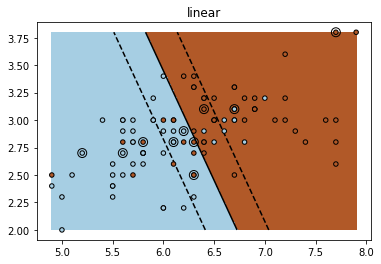

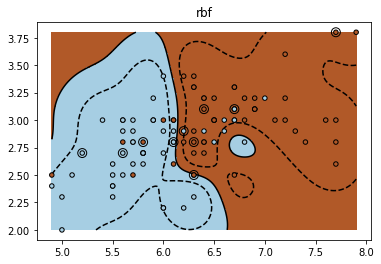

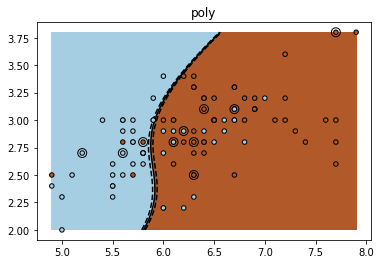

In [133]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn import datasets, svm

#Same as above we are first loading the iris data set
#Setting X to the data, length and width of the pedals and sepals
#Setting y to the target, which species of iris the data belongs to. Species are set to 0,1,2 for setosa', 'versicolor', 'virginica'
iris = datasets.load_iris()
X = iris.data
y = iris.target

#Since we are looking to classify only 1 and 2 classes, versicolor and virginica we can can omit class 0, setosa
#We slice the X array where y does not equal 0, setosa
#And since we only wan the first two features, we will slice everything till the second feature, :2
#From y, we want all classes that is not setosa, y != 0

X = X[y != 0, :2]
y = y[y != 0]

n_sample = len(X)

np.random.seed(0)

#Set the order for testing in our training and test
order = np.random.permutation(n_sample)
X = X[order]
y = y[order].astype(np.float)

#Taking the first 90% of X and y as our training data
X_train = X[:int(.9 * n_sample)]
y_train = y[:int(.9 * n_sample)]

#Taking the remainder as our test data
X_test = X[int(.9 * n_sample):]
y_test = y[int(.9 * n_sample):]

#fit the model with the SVC Kernal type where Kernal type is kernal trick were we can apply nonlinear data into higher
#dimensional space making it linearly separable
#https://towardsdatascience.com/svm-feature-selection-and-kernels-840781cc1a6c

for kernel in ('linear', 'rbf', 'poly'):
    clf = svm.SVC(kernel=kernel, gamma=10)
    clf.fit(X_train, y_train)

    plt.figure()
    plt.clf()
    plt.scatter(X[:, 0], X[:, 1], c=y, zorder=10, cmap=plt.cm.Paired,
                edgecolor='k', s=20)

    # Circle out the test data
    plt.scatter(X_test[:, 0], X_test[:, 1], s=80, facecolors='none',
                zorder=10, edgecolor='k')

    plt.axis('tight')
    x_min = X[:, 0].min()
    x_max = X[:, 0].max()
    y_min = X[:, 1].min()
    y_max = X[:, 1].max()

    XX, YY = np.mgrid[x_min:x_max:200j, y_min:y_max:200j]
    Z = clf.decision_function(np.c_[XX.ravel(), YY.ravel()])

    # Put the result into a color plot
    Z = Z.reshape(XX.shape)
    plt.pcolormesh(XX, YY, Z > 0, cmap=plt.cm.Paired)
    plt.contour(XX, YY, Z, colors=['k', 'k', 'k'],
                linestyles=['--', '-', '--'], levels=[-.5, 0, .5])

    plt.title(kernel)
plt.show()